# PP240B - ACA Evaluation
### Prepared by Peter Amerkhanian, 4/28/2022

# Prompt: 
Has the Affordable Care Act (ACA) Increased Insurance Coverage for Young
Adults? In an effort to increase health insurance coverage rates for young adults, the
ACA required health insurance companies to provide insurance for children under age 26
through their parent’s coverage. Using data from the March Current Population Survey
for people aged 19-29, you are to estimate the impact of the ACA on insurance coverage
rates for people under 26.  
- This project will require that students read ahead about “difference-in-difference” models, but this is a fun and great project. The data set is named “aca_data_march_cps.dta”.  
- Most difficult aspect of project: Will require some work learning about the ACA and reading ahead about “difference-in-difference” models.

### Notes:
1. The ACA was was "signed into law on March 23, 2010 and was amended by the Health Care and Education Reconciliation Act on March 30, 2010" [(source)](https://www.hhs.gov/answers/health-insurance-reform/what-is-the-affordable-care-act/index.html)
2. "the March 2010 survey asks questions about insurance status in 2009, so please be careful when you are defining when the ACA goes into effect." - Rucker

In [1]:
import pandas as pd
import plotly.express as px
import numpy as np
import scipy.stats
from matplotlib import pyplot as plt
import seaborn as sns
sns.set_theme()

In [2]:
df = pd.read_stata("Impact_ACA/aca_data_march_cps.dta")
df.head()

,year,age,female,race_ethnic,any_insurance,pvt_insurance,emp_prov_ins,medicaid,state
0,2005,27,0,1,1,0,0,1,23
1,2005,26,1,1,0,0,0,0,23
2,2005,22,0,1,1,1,1,0,23
3,2005,21,1,1,1,1,1,0,23
4,2005,20,1,1,1,0,0,0,23


Given Note 1., I define pre-ACA as before 2011 (in 2011, CPS respondents reported 2010 coverage) and post-ACA as during and after 2011

In [62]:
df_pre_aca = df.query("year < 2011")
df_post_aca = df.query("year >= 2011")

## 1. Overall Descriptive Comparison  
### How did health insurance coverage rates change in the aggregate? 
### Findings:
- Overall insurance coverage increased
- Private insurance coverage decreased
- Employer provided insurance coverage decreased
- Medicaid coverage increased

##### Pre ACA Summary Statistics:

In [63]:
df_pre_aca.describe().iloc[0:3, 3:7]

,any_insurance,pvt_insurance,emp_prov_ins,medicaid
count,165553.000000,165553.000000,165553.000000,165553.000000
mean,0.714309,0.602774,0.519513,0.115389
std,0.451744,0.489325,0.499621,0.319492


##### Post ACA Summary Statistics:

In [64]:
df_post_aca.describe().iloc[0:3, 3:7]

,any_insurance,pvt_insurance,emp_prov_ins,medicaid
count,81376.000000,81376.000000,81376.000000,81376.000000
mean,0.718320,0.586143,0.484283,0.137522
std,0.449821,0.492526,0.499756,0.344400


- Overall Health insurance coverage (defined by the `any_insurance` variable) appears to have increased slightly between the pre and post ACA passage periods - $71.4\%$ coverage before and $71.8\%$ coverage after 
- It appears that private and employer provided insurance coverage rates fell, while medicaid coverage increased.
  
#### Significance of Overall Changes in Coverage:
I perform a parametric two-sided $t$-test below at $95\%$ confidence below assuming equal variance and find that **post-aca has a higher overall coverage rate** with $p=0.0378$

In [65]:
t_test = scipy.stats.ttest_ind(
    a=df_post_aca['any_insurance'],
    b=df_pre_aca['any_insurance'],
    equal_var=True,
    alternative='two-sided')
print("T =", t_test.statistic)
print("p value =", t_test.pvalue)

T = 2.076763771196662
p value = 0.0378243990645094


Out of curiosity I also perform non-parametric bootstrap hypothesis tests to check the stability of the results **([source](https://en.wikipedia.org/wiki/Bootstrapping_(statistics)#Bootstrap_hypothesis_testing))** for all types of health insurance coverage

In [66]:
def bootstrap_test(variable):
    t_test = scipy.stats.ttest_ind(
        a=df_post_aca[variable],
        b=df_pre_aca[variable],
        equal_var=False,
        alternative='two-sided')
    differences = []
    B = 2000
    for i in range(B):
        sample_pre_aca = (
            df_pre_aca[variable].sample(1000, replace=True)
            - df_pre_aca[variable].mean() + df[variable].mean()
        )
        sample_post_aca = (
            df_post_aca[variable].sample(1000, replace=True)
            - df_post_aca[variable].mean() + df[variable].mean()
        )
        t = scipy.stats.ttest_ind(
            a=sample_post_aca,
            b=sample_pre_aca,
            equal_var=False,
            alternative='two-sided')
        differences.append(np.abs(t.statistic))
    print("Bootstrap T-test for", variable)
    print("T =", t_test.statistic)
    print("t-dist p value =", t_test.pvalue)
    print("bootstrap-dist p value =",
          np.sum((pd.Series(differences) >= np.abs(t_test.statistic))) / B)

Tests for each type of insurance reinforce the findings of the descriptive statistics:
- Overall insurance coverage INCREASED
- Private insurance coverage DECREASED
- Employer provided insurance coverage DECREASED
-  Medicaid coverage INCREASED

In [67]:
bootstrap_test('any_insurance')

Bootstrap T-test for any_insurance
T = 2.079786518936761
t-dist p value = 0.03754668241936156
bootstrap-dist p value = 0.039


In [68]:
bootstrap_test('pvt_insurance')

Bootstrap T-test for pvt_insurance
T = -7.903746846440043
t-dist p value = 2.7234069113967902e-15
bootstrap-dist p value = 0.0


In [69]:
bootstrap_test('emp_prov_ins')

Bootstrap T-test for emp_prov_ins
T = -16.467621738493047
t-dist p value = 7.028117404390499e-61
bootstrap-dist p value = 0.0


In [70]:
bootstrap_test('medicaid')

Bootstrap T-test for medicaid
T = 15.368199130661067
t-dist p value = 2.935011020492666e-53
bootstrap-dist p value = 0.0


## 2. Disaggregated Trends

In this section, I'll start with some processing of the data:
- I add in the text of each state name using a third party source (see `url` below)
- I add a dummy variable for pre/post ACA as defined above
- I create a column with the text name of each race/ethnic group

Add in state name text:

In [71]:
url = "https://gist.githubusercontent.com/dantonnoriega/bf1acd2290e15b91e6710b6fd3be0a53/raw/11d15233327c8080c9646c7e1f23052659db251d/us-state-ansi-fips.csv"
fips = pd.read_csv(url).set_index(" st")
df_full = pd.merge(df, fips[["stname"]], left_on="state", right_index=True)

Implementation of the pre-post ACA dummy:

In [72]:
df_full["post_aca"] = (df_full["year"] >= 2011).astype(int)
df_full["post_aca_text"] = df_full["post_aca"].apply(lambda x: "Post" if x else "Pre")

The mapping of race/ethnic groups as follows:  
=1 of white, non-Hispanic, =2 if black, non-Hispanic, =3 if other race, nonHispanic, =4 if Hispanic

In [73]:
df_full["race_text"] = (df_full["race_ethnic"]
                        .map(
                            {1: "White, non-Hispanic",
                             2: "Black, non-Hispanic",
                             3: "Other race, non-Hispanic",
                             4: "Hispanic"})
                        )

At this point, the data look like this:

In [74]:
df_full["age"] = df_full["age"].astype(int)

At this point I'll add a 1-0 dummy variable that is 1 if the respondent is under 26 and 0 otherwise.

In [75]:
df_full["under_26"] = ((df_full["age"] > 19) & (df_full["age"] < 26)).astype(int)
df_full["under_26_text"] = df_full["under_26"].apply(lambda x: "Under 26" if x else "26-29")

In [39]:
# df_full = pd.concat([df_full, pd.get_dummies(df_full["stname"])], axis=1)

In [40]:
# df_full = df_full.drop(columns="California")

In [76]:
pd.get_dummies(df_full["race_text"]).describe()

,"Black, non-Hispanic",Hispanic,"Other race, non-Hispanic","White, non-Hispanic"
count,246929.000000,246929.000000,246929.000000,246929.000000
mean,0.124817,0.222432,0.089220,0.563530
std,0.330512,0.415881,0.285062,0.495948
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,1.000000
75%,0.000000,0.000000,0.000000,1.000000
max,1.000000,1.000000,1.000000,1.000000


In [79]:
df_full = pd.concat([df_full, pd.get_dummies(df_full["race_text"])], axis=1)
df_full = df_full.drop(columns="White, non-Hispanic")

In [81]:
regions = pd.read_csv("https://raw.githubusercontent.com/cphalpert/census-regions/master/us%20census%20bureau%20regions%20and%20divisions.csv")

In [82]:
df_with_region = pd.merge(df_full, regions[["State", "Region"]], left_on="stname", right_on="State")

In [83]:
df_with_region_dummies = pd.concat([df_with_region, pd.get_dummies(df_with_region["Region"])], axis=1)
df_with_region_dummies = df_with_region_dummies.drop(columns=["West", "Region"])
# Save our data
df_with_region_dummies.to_csv("Impact_ACA/data_with_dummies.csv")

In [84]:
df_with_region_dummies.describe()

,year,age,female,race_ethnic,any_insurance,pvt_insurance,emp_prov_ins,medicaid,state,post_aca,under_26,"Black, non-Hispanic",Hispanic,"Other race, non-Hispanic","Black, non-Hispanic",Hispanic,"Other race, non-Hispanic",Midwest,Northeast,South
count,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000,246929.000000
mean,2008.989791,24.040773,0.515573,1.970554,0.715631,0.597293,0.507903,0.122683,27.390809,0.329552,0.532554,0.124817,0.222432,0.089220,0.124817,0.222432,0.089220,0.224899,0.180509,0.315370
std,2.572519,3.198217,0.499758,1.241620,0.451114,0.490444,0.499939,0.328074,16.111395,0.470052,0.498940,0.330512,0.415881,0.285062,0.330512,0.415881,0.285062,0.417516,0.384612,0.464664
min,2005.000000,19.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2007.000000,21.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,2009.000000,24.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,27.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,2011.000000,27.000000,1.000000,3.000000,1.000000,1.000000,1.000000,0.000000,41.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
max,2013.000000,29.000000,1.000000,4.000000,1.000000,1.000000,1.000000,1.000000,56.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [85]:
data_reg = df_with_region_dummies[["any_insurance", "Midwest", "Northeast", "South", "under_26", "Black, non-Hispanic", "Hispanic", "Other race, non-Hispanic"]]

### Disaggregated by Race:

Disaggregating by race/ethnicity **suggests** that overall,
- Insurance rates for white respondents stayed basically the same
- Insurance rates for Other race, non Hispanic respondents INCREASED
- Insurance rates for Hispanic respondents INCREASED
- Insurance rates for Black, non-Hispanic respondents stayed basically the same  

**However,** Medicaid coverage rates INCREASED for every group, especially for Hispanic respondents and Black, non-Hispanic respondent

In [97]:
changes = (df_full
           .groupby(["race_text", "post_aca_text"])
           .mean()
           .iloc[:, 4:8])
changes = changes.sort_values(by=["race_text", "post_aca_text"],
                              ascending=False)
print(round(changes, 3).to_latex(index=True,
                          escape=False))

\begin{tabular}{llrrrr}
\toprule
                    &      &  any_insurance &  pvt_insurance &  emp_prov_ins &  medicaid \\
race_text & post_aca_text &                &                &               &           \\
\midrule
White, non-Hispanic & Pre &          0.788 &          0.695 &         0.592 &     0.097 \\
                    & Post &          0.788 &          0.679 &         0.554 &     0.113 \\
Other race, non-Hispanic & Pre &          0.725 &          0.617 &         0.526 &     0.109 \\
                    & Post &          0.740 &          0.630 &         0.511 &     0.123 \\
Hispanic & Pre &          0.531 &          0.414 &         0.371 &     0.122 \\
                    & Post &          0.563 &          0.416 &         0.359 &     0.155 \\
Black, non-Hispanic & Pre &          0.689 &          0.501 &         0.442 &     0.192 \\
                    & Post &          0.681 &          0.467 &         0.393 &     0.220 \\
\bottomrule
\end{tabular}



In [87]:
fig = px.histogram(df_full,
                   title="Changes in Any Health Insurance Coverage by Race/Ethnicity, Pre and Post ACA",
                   x="race_text",
                   y="any_insurance",
                   color='post_aca_text',
                   barmode='group',
                   histfunc='avg',
                   height=400)
fig.show()

In [88]:
fig = px.histogram(df_full,
                   title="Changes in Medicaid Coverage by Race/Ethnicity, Pre and Post ACA",
                   x="race_text",
                   y="medicaid",
                   color='post_aca_text',
                   barmode='group',
                   histfunc='avg',
                   height=400)
fig.show()

### Disaggregated by Age

Disaggregating by age **suggests** that overall,
- Overall insurance rates for those under 26 greatly increased - from $0.693$ to $0.713$
  - **Increases in overall insurance rates looks like it was statistically significant for 20, 21, 22, and 23 year olds, but not for 19, 20, 24, or 25 year olds**.
- Overall insurance rates for those 26-29 slightly decreased - from $0.739$ to $0.725$, though that group still had increases in Medicaid coverage.
  - **Decreases were statistically significant for ages 27, 28, and 29**



In [89]:
changes_age = (df_full
           .groupby(["under_26_text", "post_aca_text"])
           .mean()
           .iloc[:, 4:8])
changes_age = changes_age.sort_values(by=["under_26_text", "post_aca_text"],
                              ascending=False)
round(changes_age, 3)

any_insurance  pvt_insurance  emp_prov_ins  \
under_26_text post_aca_text                                               
Under 26      Pre                    0.693          0.579         0.475   
              Post                   0.713          0.580         0.445   
26-29         Pre                    0.739          0.630         0.571   
              Post                   0.725          0.594         0.528   

                             medicaid  
under_26_text post_aca_text            
Under 26      Pre               0.118  
              Post              0.140  
26-29         Pre               0.113  
              Post              0.135

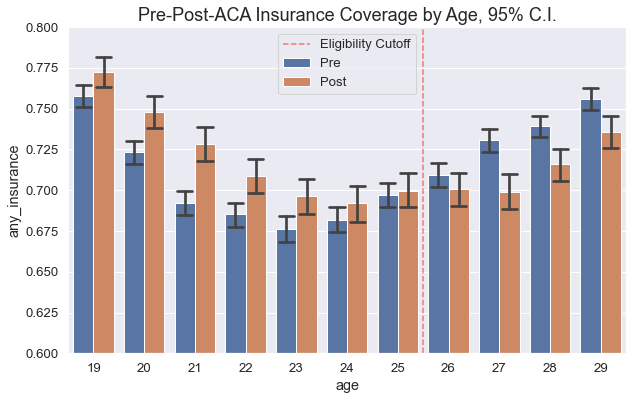

In [90]:
plt.figure(figsize=(10, 6))
sns.barplot(data=df_full,
            x="age",
            y="any_insurance",
            hue="post_aca_text",
            capsize=.3)
plt.axvline(6.5, c="red", alpha=.5, linestyle="--", label="Eligibility Cutoff")
plt.legend()
plt.ylim(0.6, 0.8)
plt.title("Pre-Post-ACA Insurance Coverage by Age, 95% C.I.").set_fontsize(18)

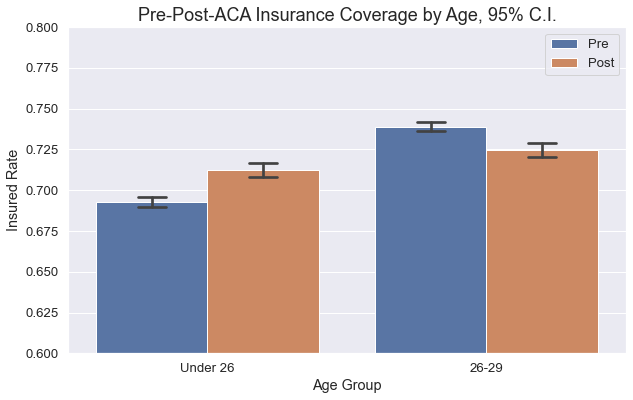

In [91]:
sns.set(font_scale = 1.2)

plt.figure(figsize=(10, 6))
sns.barplot(data=df_full.sort_values(by="under_26_text", ascending=False),
            x="under_26_text",
            y="any_insurance",
            hue="post_aca_text", capsize=.1)
plt.legend()
plt.xlabel("Age Group")
plt.ylabel("Insured Rate")
plt.ylim(0.6, 0.8)
plt.title("Pre-Post-ACA Insurance Coverage by Age, 95% C.I.").set_fontsize(18)
plt.savefig("age_group.png", dpi=400)

No handles with labels found to put in legend.


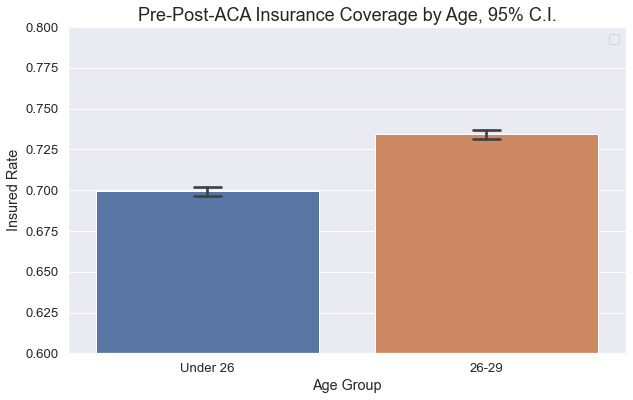

In [92]:
sns.set(font_scale = 1.2)

plt.figure(figsize=(10, 6))
sns.barplot(data=df_full.sort_values(by="under_26_text", ascending=False),
            x="under_26_text",
            y="any_insurance", capsize=.1)
plt.legend()
plt.xlabel("Age Group")
plt.ylabel("Insured Rate")
plt.ylim(0.6, 0.8)
plt.title("Pre-Post-ACA Insurance Coverage by Age, 95% C.I.").set_fontsize(18)
plt.savefig("age_group.png", dpi=400)

In [100]:
fig = px.histogram(df_full,
                   title="Changes in Medicaid Coverage by Age, Pre and Post ACA",
                   x="age",
                   y="medicaid",
                   color='post_aca_text',
                   barmode='group',
                   histfunc='avg',
                   height=500)
fig.add_vline(x=25.5, line_width=3, line_dash="dash", line_color="black", annotation_text="Eligibility Cutoff")
fig.show()

## 2. Parallel Trend Assumptions

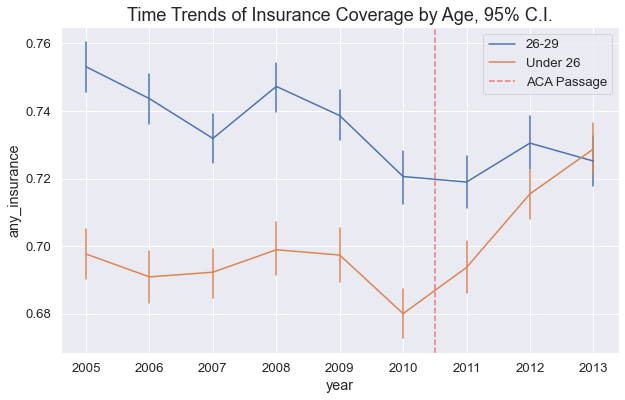

In [99]:
plt.figure(figsize=(10,6))
sns.lineplot(data=df_full,
             x="year",
             y="any_insurance",
             hue="under_26_text",
             err_style="bars")
plt.axvline(2010.5, c="red", alpha=.5, linestyle="--", label="ACA Passage")
plt.legend()
plt.title("Time Trends of Insurance Coverage by Age, 95% C.I.").set_fontsize(18)
plt.savefig("fig.png", dpi=400)